# Air Craft Detection using IceVision

## Installing IceVision and IceData


In [1]:
!wget https://raw.githubusercontent.com/airctic/icevision/master/icevision_install.sh

--2022-09-26 17:23:30--  https://raw.githubusercontent.com/airctic/icevision/master/icevision_install.sh
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2820 (2.8K) [text/plain]
Saving to: ‘icevision_install.sh’

icevision_install.s 100%[===================>]   2.75K  --.-KB/s    in 0s      

2022-09-26 17:23:30 (35.1 MB/s) - ‘icevision_install.sh’ saved [2820/2820]



In [2]:
# Torch - Torchvision - IceVision - IceData - MMDetection - YOLOv5 - EfficientDet Installation

# Choose your installation target: cuda11 or cuda10 or cpu
!bash icevision_install.sh cuda11 master


Installing icevision + dependencices for cuda11
- Installing torch and its dependencies
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 GB 525.3 kB/s eta 0:00:000:0100:02
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 22.5 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.0/8.0 MB 10.4 MB/s eta 0:00:0000:0100:01m
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0
    Uninstalling torch-1.11.0:
      Successfully uninstalled torch-1.11.0
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.12.0
    Uninstalling torchvision-0.12.0:
      Successfully uninstalled torchvision-0.12.0
  Attempting uninstall: torchtext
    Found existing installation: torchtext 0.12.0
    Uninstalling torchtext-0.12.0:
      Successfully uninstalled torchtext-0.12.0
ERROR: pip's dependency resolver does not currently take into account all the pa

In [1]:
import IPython
IPython.Application.instance().kernel.do_shutdown(True)

{'status': 'ok', 'restart': True}

## Imports

In [ ]:
# !pip install --upgrade -q wandb

In [ ]:
# from kaggle_secrets import UserSecretsClient
# user_secrets = UserSecretsClient()
# wandb_api = user_secrets.get_secret("wandb_api")

In [ ]:
# import wandb
# from wandb.keras import WandbCallback
# wandb.login(key=wandb_api)

In [2]:
from icevision.all import *
import os
import ast
import random
import pandas as pd
from fastai.callback.wandb import *
from fastai.callback.tracker import SaveModelCallback
from icevision.imports import *
from icevision.utils import *
from icevision.data import *
from icevision.metrics.metric import *

In [3]:
!cp -r ../input/airbus-aircrafts-sample-dataset ./

In [4]:
!ls

__notebook_source__.ipynb	 icevision_install.sh
airbus-aircrafts-sample-dataset


In [ ]:
!pwd

## Visual Inspection

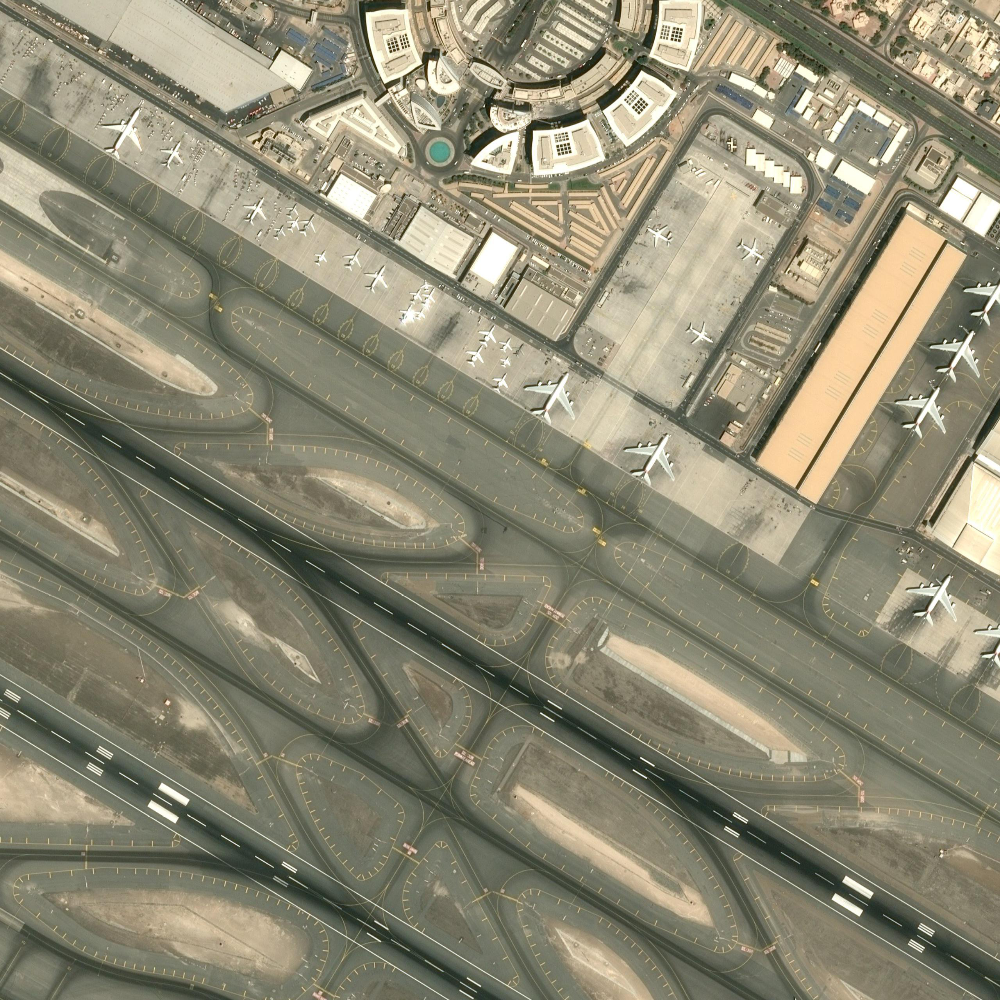

In [5]:
DATA_DIR = Path('./airbus-aircrafts-sample-dataset')
img_list = list(DATA_DIR.glob('images/*.jpg'))
pickone = random.choice(img_list)
img = PIL.Image.open(pickone)
display(img)

In [6]:
only_files = [DATA_DIR / f.name for f in img_list if os.path.isfile(f) and f.name[-4:] == ".jpg"]
print("Found {} images files in {}".format(len(only_files), DATA_DIR))

IMAGE_HEIGHT, IMAGE_WIDTH = img.size
num_channels = len(img.mode)
print("Image size: {}".format((IMAGE_HEIGHT, IMAGE_WIDTH)))
print("Num channels: {}".format(num_channels))

Found 103 images files in airbus-aircrafts-sample-dataset
Image size: (2560, 2560)
Num channels: 3


## Read CSV file

In [7]:
df = pd.read_csv(DATA_DIR / 'annotations.csv')

### `geometry` is encoded as string


In [8]:
geometry = df.loc[0]['geometry']
geometry

'[(135, 522), (245, 522), (245, 600), (135, 600), (135, 522)]'

In [9]:
geometry2 = ast.literal_eval(geometry.rstrip('\r\n'))
geometry2

[(135, 522), (245, 522), (245, 600), (135, 600), (135, 522)]

### Converting `geometry` column to a proper format

In [10]:
# convert a string record into a valid python object
def f(x): 
    return ast.literal_eval(x.rstrip('\r\n'))

df = pd.read_csv(DATA_DIR / "annotations.csv", 
                converters={'geometry': f})
df.head(10)

,id,image_id,geometry,class
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600), (135, 522)]",Airplane
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025, 384), (1025, 284)]",Airplane
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (1058, 1568), (1058, 1503)]",Airplane
3,4,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(813, 1518), (885, 1518), (885, 1604), (813, 1604), (813, 1518)]",Airplane
4,5,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(594, 938), (657, 938), (657, 1012), (594, 1012), (594, 938)]",Airplane
5,6,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(451, 725), (524, 725), (524, 798), (451, 798), (451, 725)]",Airplane
6,7,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1543, 1437), (1614, 1437), (1614, 1497), (1543, 1497), (1543, 1437)]",Airplane
7,8,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1485, 1370), (1561, 1370), (1561, 1437), (1485, 1437), (1485, 1370)]",Airplane
8,9,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1968, 1624), (2053, 1624), (2053, 1687), (1968, 1687), (1968, 1624)]",Airplane
9,10,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1659, 1674), (1733, 1674), (1733, 1746), (1659, 1746), (1659, 1674)]",Airplane


### Calcutation the Bounding Box `(xmin, ymin, xmax, ymax)`

In [11]:
geometry = df.loc[0]['geometry']
geometry

[(135, 522), (245, 522), (245, 600), (135, 600), (135, 522)]

In [12]:
arr = np.array(geometry).T

In [13]:
xmin = np.min(arr[0])
ymin = np.min(arr[1])
xmax = np.max(arr[0])
ymax = np.max(arr[1])
(xmin, ymin, xmax, ymax)

(135, 522, 245, 600)

### Updating the dataframe 

In [14]:
def getBounds(geometry):
    try: 
        arr = np.array(geometry).T
        xmin = np.min(arr[0])
        ymin = np.min(arr[1])
        xmax = np.max(arr[0])
        ymax = np.max(arr[1])
        return (xmin, ymin, xmax, ymax)
    except:
        return np.nan

def getWidth(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(xmax - xmin)
    except:
        return np.nan

def getHeight(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(ymax - ymin)
    except:
        return np.nan

df.rename(columns={'class':'label'}, inplace=True) # to avoid semantic conflicts

# Create bounds, width and height
df.loc[:,'bounds'] = df.loc[:,'geometry'].apply(getBounds)
df.loc[:,'width'] = df.loc[:,'bounds'].apply(getWidth)
df.loc[:,'height'] = df.loc[:,'bounds'].apply(getHeight)
df.head(10)

,id,image_id,geometry,label,bounds,width,height
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600), (135, 522)]",Airplane,"(135, 522, 245, 600)",110,78
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025, 384), (1025, 284)]",Airplane,"(1025, 284, 1125, 384)",100,100
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (1058, 1568), (1058, 1503)]",Airplane,"(1058, 1503, 1130, 1568)",72,65
3,4,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(813, 1518), (885, 1518), (885, 1604), (813, 1604), (813, 1518)]",Airplane,"(813, 1518, 885, 1604)",72,86
4,5,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(594, 938), (657, 938), (657, 1012), (594, 1012), (594, 938)]",Airplane,"(594, 938, 657, 1012)",63,74
5,6,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(451, 725), (524, 725), (524, 798), (451, 798), (451, 725)]",Airplane,"(451, 725, 524, 798)",73,73
6,7,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1543, 1437), (1614, 1437), (1614, 1497), (1543, 1497), (1543, 1437)]",Airplane,"(1543, 1437, 1614, 1497)",71,60
7,8,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1485, 1370), (1561, 1370), (1561, 1437), (1485, 1437), (1485, 1370)]",Airplane,"(1485, 1370, 1561, 1437)",76,67
8,9,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1968, 1624), (2053, 1624), (2053, 1687), (1968, 1687), (1968, 1624)]",Airplane,"(1968, 1624, 2053, 1687)",85,63
9,10,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1659, 1674), (1733, 1674), (1733, 1746), (1659, 1746), (1659, 1674)]",Airplane,"(1659, 1674, 1733, 1746)",74,72


## Create the Parser

The first step is to create a template record for our specific type of dataset, in this case we're doing standard object detection:

In [15]:
template_record = ObjectDetectionRecord()

Now use the method `generate_template` that will print out all the necessary steps we have to implement.

In [16]:
Parser.generate_template(template_record)

class MyParser(Parser):
    def __init__(self, template_record):
        super().__init__(template_record=template_record)
    def __iter__(self) -> Any:
    def __len__(self) -> int:
    def record_id(self, o: Any) -> Hashable:
    def parse_fields(self, o: Any, record: BaseRecord, is_new: bool):
        record.set_filepath(<Union[str, Path]>)
        record.set_img_size(<ImgSize>)
        record.detection.set_class_map(<ClassMap>)
        record.detection.add_labels(<Sequence[Hashable]>)
        record.detection.add_bboxes(<Sequence[BBox]>)


We can copy the template and use it as our starting point. Let's go over each of the methods we have to define:

- `__init__`: What happens here is completely up to you, normally we have to pass some reference to our data, `data_dir` in our case.

- `__iter__`: This tells our parser how to iterate over our data, each item returned here will be passed to `parse_fields` as `o`. In our case we call `df.itertuples` to iterate over all `df` rows.

- `__len__`: How many items will be iterating over.

- `imageid`: Should return a `Hashable` (`int`, `str`, etc). In our case we want all the dataset items that have the same `filename` to be unified in the same record.

- `parse_fields`: Here is where the attributes of the record are collected, the template will suggest what methods we need to call on the record and what parameters it expects. The parameter `o` it receives is the item returned by `__iter__`.

!!! danger "Important"  
    Be sure to pass the correct type on all record methods!

In [17]:
class AirbusParser(Parser):
    # convert a string record into a valid python object
    def convert_fn(x): 
        return ast.literal_eval(x.rstrip('\r\n'))

    def __init__(self, template_record, data_dir, df):
        super().__init__(template_record=template_record)
        
        self.data_dir = data_dir
        # self.df = pd.read_csv(data_dir / "annotations.csv", converters={'geometry': self.convert_fn})
        self.df = df

        self.class_map = ClassMap(list(self.df['label'].unique()))
        

    def __iter__(self) -> Any:
        for o in self.df.itertuples():
            yield o
        
    def __len__(self) -> int:
        return len(self.df)
        
    def record_id(self, o) -> Hashable:
        return o.image_id
        
    def parse_fields(self, o, record, is_new):
        if is_new:
            
            filepath = self.data_dir / 'images' / o.image_id
            record.set_filepath(filepath)
            
            if filepath.exists():
              image_size = get_img_size(filepath)
              record.set_img_size(image_size)
            
            record.detection.set_class_map(self.class_map)
        

        (xmin, ymin, xmax, ymax) = o.bounds
        record.detection.add_bboxes([BBox.from_xyxy(xmin, ymin, xmax, ymax)])
        record.detection.add_labels([o.label])

Let's randomly split the data and parser with `Parser.parse`:

In [18]:
data_dir = Path('./airbus-aircrafts-sample-dataset')
data_dir

Path('airbus-aircrafts-sample-dataset')

In [19]:
data_dir.ls()

(#5) [Path('airbus-aircrafts-sample-dataset/images'),Path('airbus-aircrafts-sample-dataset/README.md'),Path('airbus-aircrafts-sample-dataset/LICENSE.txt'),Path('airbus-aircrafts-sample-dataset/annotations.csv'),Path('airbus-aircrafts-sample-dataset/extras')]

In [20]:
parser = AirbusParser(template_record, data_dir, df)

In [21]:
train_records, valid_records = parser.parse()

  0%|          | 0/3425 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/103 [00:00<?, ?it/s]

AUTOFIX-SUCCESS - (record_id: b6e9f8fc-3fbd-411a-a1e5-b853e8fbe2ac.jpg) - Clipping bbox xmax from 2561 to image width 2560 (Before: <BBox (xmin:2493, ymin:713, xmax:2561, ymax:826)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 57af3c0a-b5ae-4e4f-a7f9-6856be2f80e5.jpg) - Clipping bbox ymax from 2562 to image height 2560 (Before: <BBox (xmin:688, ymin:2432, xmax:831, ymax:2562)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 78400c58-1a7c-4342-a1fb-2117cb7cbc8b.jpg) - Clipping bbox xmax from 2567 to image width 2560 (Before: <BBox (xmin:2495, ymin:405, xmax:2567, ymax:552)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 7635d63c-6b97-4c9c-a7dc-27773d42ed4c.jpg) - Clipping bbox xmax from 2564 to image width 2560 (Before: <BBox (xmin:2454, ymin:862, xmax:2564, ymax:1021)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: e9021b38-0b3c-484f-af2c-b36bbf765f85.jpg) - Clipping

Let's take a look at one record:

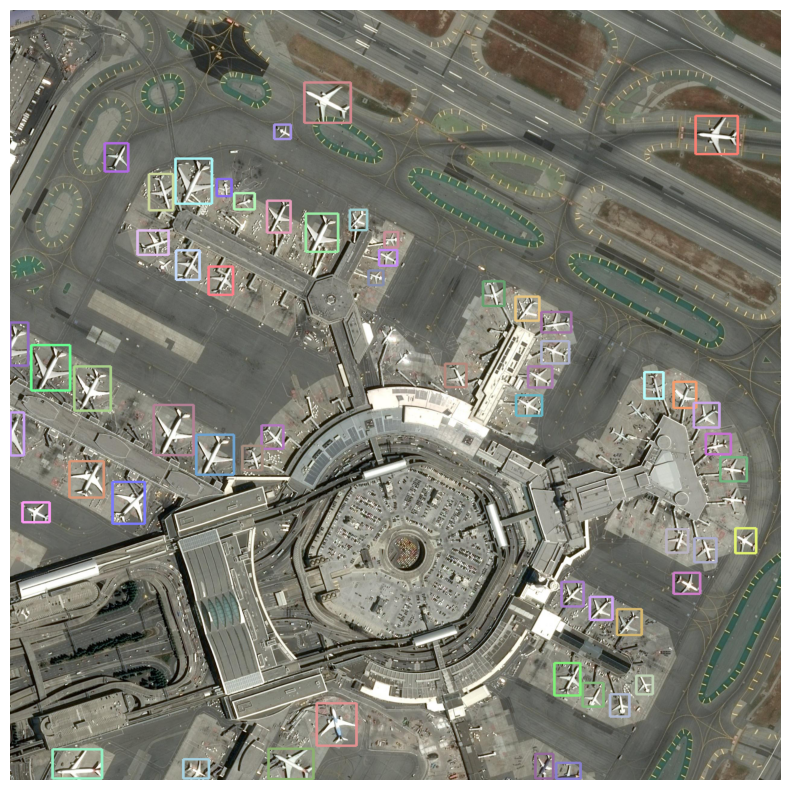

In [22]:
show_record(train_records[0], display_label=False, figsize=(14, 10))

In [23]:
train_records[0]

BaseRecord

common: 
	- Filepath: airbus-aircrafts-sample-dataset/images/3e321b8a-9504-45aa-82b4-16158e28e290.jpg
	- Img: None
	- Image size ImgSize(width=2560, height=2560)
	- Record ID: 3e321b8a-9504-45aa-82b4-16158e28e290.jpg
detection: 
	- Class Map: <ClassMap: {'background': 0, 'Airplane': 1, 'Truncated_airplane': 2}>
	- Labels: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 2]
	- BBoxes: [<BBox (xmin:977, ymin:240, xmax:1131, ymax:375)>, <BBox (xmin:877, ymin:380, xmax:932, ymax:429)>, <BBox (xmin:2276, ymin:351, xmax:2416, ymax:479)>, <BBox (xmin:1570, ymin:901, xmax:1641, ymax:984)>, <BBox (xmin:982, ymin:676, xmax:1089, ymax:804)>, <BBox (xmin:549, ymin:493, xmax:670, ymax:644)>, <BBox (xmin:314, ymin:442, xmax:392, ymax:537)>, <BBox (xmin:461, ymin:544, xmax:541, ymax:666)>, <BBox (xmin:423, ymin:732, xmax:526, ymax:814)>, <BBox (xmin:551, ymin:798, xmax:6

In [24]:
# Transforms
# size is set to 384 because EfficientDet requires its inputs to be divisible by 128
# Try image_size = 512 or image_size = 640 or image_size = 768 (incrementing by 128px)
image_size = 640
presize = image_size + 128
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=presize), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

In [25]:
# Datasets
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

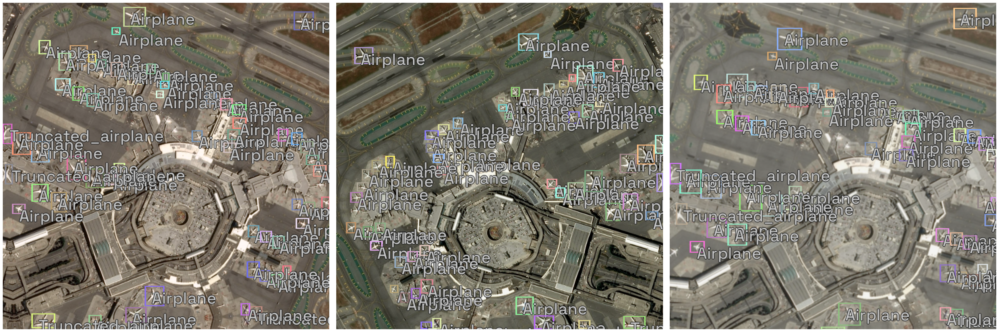

In [26]:
# Show an element of the train_ds with augmentation transformations applied
samples = [train_ds[0] for _ in range(3)]
show_samples(samples, ncols=3)

## Models

We've selected a few of the many options below. You can easily pick which libraries, models, and backbones you like to use.

In [27]:
# Just change the value of selection to try another model

selection = 13

extra_args = {}

if selection == 0:
  model_type = models.mmdet.vfnet
  backbone = model_type.backbones.resnet50_fpn_mstrain_2x

if selection == 1:
  model_type = models.mmdet.retinanet
  backbone = model_type.backbones.resnet50_fpn_1x
  # extra_args['cfg_options'] = { 
  #   'model.bbox_head.loss_bbox.loss_weight': 2,
  #   'model.bbox_head.loss_cls.loss_weight': 0.8,
  #    }

if selection == 2:
  model_type = models.mmdet.faster_rcnn
  backbone = model_type.backbones.resnet101_fpn_2x
  # extra_args['cfg_options'] = { 
  #   'model.roi_head.bbox_head.loss_bbox.loss_weight': 2,
  #   'model.roi_head.bbox_head.loss_cls.loss_weight': 0.8,
  #    }

if selection == 3:
  model_type = models.mmdet.ssd
  backbone = model_type.backbones.ssd300

if selection == 4:
  model_type = models.mmdet.yolox
  backbone = model_type.backbones.yolox_s_8x8

if selection == 5:
  model_type = models.mmdet.yolof
  backbone = model_type.backbones.yolof_r50_c5_8x8_1x_coco

if selection == 6:
  model_type = models.mmdet.detr
  backbone = model_type.backbones.r50_8x2_150e_coco

if selection == 7:
  model_type = models.mmdet.deformable_detr
  backbone = model_type.backbones.twostage_refine_r50_16x2_50e_coco

if selection == 8:
  model_type = models.mmdet.fsaf
  backbone = model_type.backbones.x101_64x4d_fpn_1x_coco

if selection == 9:
  model_type = models.mmdet.sabl
  backbone = model_type.backbones.r101_fpn_gn_2x_ms_640_800_coco

if selection == 10:
  model_type = models.mmdet.centripetalnet
  backbone = model_type.backbones.hourglass104_mstest_16x6_210e_coco

elif selection == 11:
  # The Retinanet model is also implemented in the torchvision library
  model_type = models.torchvision.retinanet
  backbone = model_type.backbones.resnet50_fpn

elif selection == 12:
  model_type = models.ross.efficientdet
  backbone = model_type.backbones.tf_lite0
  # The efficientdet model requires an img_size parameter
  extra_args['img_size'] = image_size

elif selection == 13:
  model_type = models.ultralytics.yolov5
  backbone = model_type.backbones.medium_p6
  # The yolov5 model requires an img_size parameter
  extra_args['img_size'] = image_size

model_type, backbone, extra_args

(<module 'icevision.models.ultralytics.yolov5' from '/opt/conda/lib/python3.7/site-packages/icevision/models/ultralytics/yolov5/__init__.py'>,
 {'img_size': 640})

In [28]:
# Instantiate the model
model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(parser.class_map), **extra_args) 

  0%|          | 0.00/69.0M [00:00<?, ?B/s]

In [29]:
# Data Loaders
train_dl = model_type.train_dl(train_ds, batch_size=8, num_workers=4, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=8, num_workers=4, shuffle=False)

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


## Training

In [30]:
class COCOMetricType(Enum):
    """Available options for `COCOMetric`."""

    bbox = "bbox"
    mask = "segm"
    keypoint = "keypoints"


class COCOMetric(Metric):
    """Wrapper around [cocoapi evaluator](https://github.com/cocodataset/cocoapi)
    Calculates average precision.
    # Arguments
        metric_type: Dependent on the task you're solving.
        print_summary: If `True`, prints a table with statistics.
        show_pbar: If `True` shows pbar when preparing the data for evaluation.
    """

    def __init__(
        self,
        metric_type: COCOMetricType = COCOMetricType.bbox,
        iou_thresholds: Optional[Sequence[float]] = None,
        print_summary: bool = False,
        show_pbar: bool = False,
    ):
        self.metric_type = metric_type
        self.iou_thresholds = iou_thresholds
        self.print_summary = print_summary
        self.show_pbar = show_pbar
        self._records, self._preds = [], []

    def _reset(self):
        self._records.clear()
        self._preds.clear()

    def accumulate(self, preds):
        for pred in preds:
            self._records.append(pred.ground_truth)
            self._preds.append(pred.pred)

    def finalize(self) -> Dict[str, float]:
        with CaptureStdout():
            coco_eval = create_coco_eval(
                records=self._records,
                preds=self._preds,
                metric_type=self.metric_type.value,
                iou_thresholds=self.iou_thresholds,
                show_pbar=self.show_pbar,
            )
            coco_eval.evaluate()
            coco_eval.accumulate()

        with CaptureStdout(propagate_stdout=self.print_summary):
            coco_eval.summarize()

        stats = coco_eval.stats
        logs = {
            "AP (IoU=0.50:0.95) area=all": stats[0],
            "AP (IoU=0.50) area=all": stats[1],
            "AP (IoU=0.75) area=all": stats[2],
            "AP (IoU=0.50:0.95) area=small": stats[3],
            "AP (IoU=0.50:0.95) area=medium": stats[4],
            "AP (IoU=0.50:0.95) area=large": stats[5],
            "AR (IoU=0.50:0.95) area=all maxDets=1": stats[6],
            "AR (IoU=0.50:0.95) area=all maxDets=10": stats[7],
            "AR (IoU=0.50:0.95) area=all maxDets=100": stats[8],
            "AR (IoU=0.50:0.95) area=small maxDets=100": stats[9],
            "AR (IoU=0.50:0.95) area=medium maxDets=100": stats[10],
            "AR (IoU=0.50:0.95) area=large maxDets=100": stats[11],
        }

        self._reset()
        return logs

In [31]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

## Training using fastai

In [ ]:
# wandb.init(project="aircraft-detection", name="yolov5-large-384", reinit=True)

In [32]:
learn = model_type.fastai.learner(dls=[train_dl, valid_dl], model=model, metrics=metrics)
#cbs=[WandbCallback(), SaveModelCallback()]

SuggestedLRs(valley=0.015848932787775993)

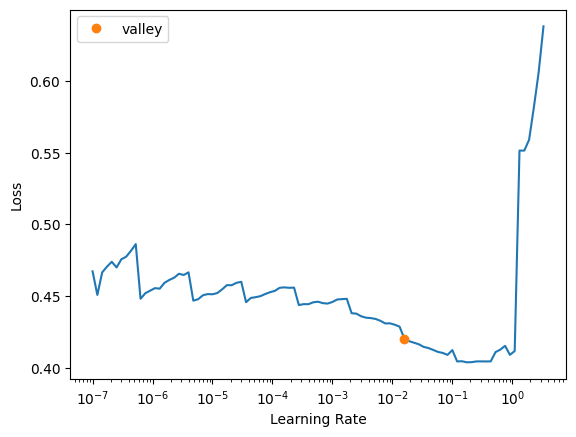

In [33]:
learn.lr_find()

In [34]:
learn.fine_tune(40, 0.015848932787775993, freeze_epochs=1)

epoch,train_loss,valid_loss,COCOMetric,time
0,0.405163,0.382924,0.000411,00:27


/opt/conda/lib/python3.7/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


epoch,train_loss,valid_loss,COCOMetric,time
0,0.323270,0.291501,0.023794,00:28
1,0.279630,0.296333,0.082868,00:27
2,0.260533,0.271266,0.107711,00:27
3,0.242498,0.228731,0.174879,00:26
4,0.229283,0.242635,0.085869,00:26
5,0.220273,0.239505,0.090265,00:26
6,0.211348,0.217586,0.121236,00:27
7,0.204581,0.227264,0.135323,00:26
8,0.197766,0.245131,0.045477,00:26
9,0.196574,0.212154,0.212729,00:27


## Training using Pytorch Lightning

In [ ]:
# class LightModel(model_type.lightning.ModelAdapter):
#     def configure_optimizers(self):
#         return Adam(self.parameters(), lr=1e-4)
    
# light_model = LightModel(model, metrics=metrics)

In [ ]:
# trainer = pl.Trainer(max_epochs=20, gpus=1)
# trainer.fit(light_model, train_dl, valid_dl)

## Showing the results

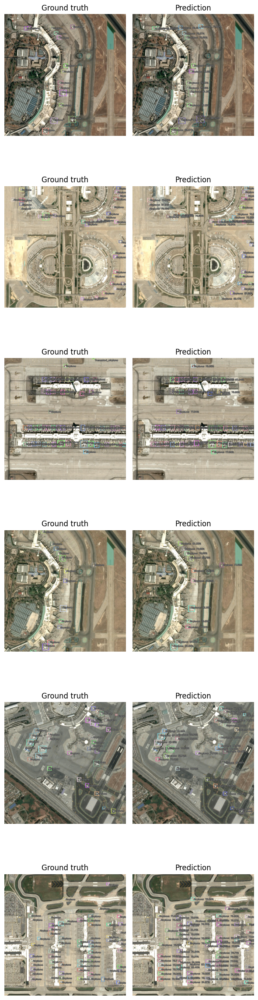

In [35]:
model_type.show_results(model, valid_ds, detection_threshold=.5)

## Batch Inference (Prediction)

In [36]:
infer_dl = model_type.infer_dl(valid_ds, batch_size=4, shuffle=False)
preds = model_type.predict_from_dl(model, infer_dl, keep_images=True)

  0%|          | 0/6 [00:00<?, ?it/s]

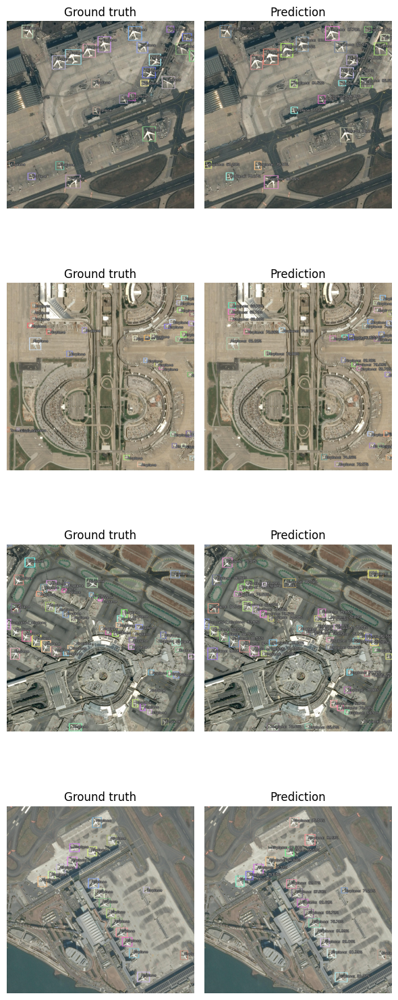

In [37]:
show_preds(preds=preds[:4])

In [ ]:
# wandb.finish()

In [38]:
from icevision.models.checkpoint import *
save_icevision_checkpoint(model,
                        model_name='ultralytics.yolov5', 
                        backbone_name='medium_p6',
                        img_size=image_size,
                        classes=parser.class_map.get_classes(),
                        filename='./models/model_checkpoint.pth',
                        meta={'icevision_version': '0.12.0'})
